Meant to be run in google collab

In [ ]:
!pip install torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 123.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 62.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 38.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 10.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 106.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjit

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import os
from tqdm import tqdm
import numpy as np
import random

In [ ]:
class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.block(x)

class UNetPP(nn.Module):
    def __init__(self, n_classes, in_channels=1, base_ch=32):
        super().__init__()

        # Encoder
        self.conv00 = ConvBlock(in_channels, base_ch)
        self.pool0 = nn.MaxPool2d(2)

        self.conv10 = ConvBlock(base_ch, base_ch * 2)
        self.pool1 = nn.MaxPool2d(2)

        self.conv20 = ConvBlock(base_ch * 2, base_ch * 4)
        self.pool2 = nn.MaxPool2d(2)

        self.conv30 = ConvBlock(base_ch * 4, base_ch * 8)
        self.pool3 = nn.MaxPool2d(2)

        self.conv40 = ConvBlock(base_ch * 8, base_ch * 16)

        # Nested decoder
        self.up01 = ConvBlock(base_ch + base_ch * 2, base_ch)
        self.up11 = ConvBlock(base_ch * 2 + base_ch * 4, base_ch * 2)
        self.up21 = ConvBlock(base_ch * 4 + base_ch * 8, base_ch * 4)
        self.up31 = ConvBlock(base_ch * 8 + base_ch * 16, base_ch * 8)

        self.up02 = ConvBlock(base_ch * 2 + base_ch, base_ch)
        self.up12 = ConvBlock(base_ch * 4 + base_ch * 2, base_ch * 2)
        self.up22 = ConvBlock(base_ch * 8 + base_ch * 4, base_ch * 4)

        self.up03 = ConvBlock(base_ch * 2 + base_ch, base_ch)
        self.up13 = ConvBlock(base_ch * 4 + base_ch * 2, base_ch * 2)

        self.up04 = ConvBlock(base_ch * 2 + base_ch, base_ch)

        self.final = nn.Conv2d(base_ch, n_classes, kernel_size=1)

    def forward(self, x):
        x00 = self.conv00(x)
        x10 = self.conv10(self.pool0(x00))
        x20 = self.conv20(self.pool1(x10))
        x30 = self.conv30(self.pool2(x20))
        x40 = self.conv40(self.pool3(x30))

        x01 = self.up01(torch.cat([x00, F.interpolate(x10, x00.shape[2:])], dim=1))
        x11 = self.up11(torch.cat([x10, F.interpolate(x20, x10.shape[2:])], dim=1))
        x21 = self.up21(torch.cat([x20, F.interpolate(x30, x20.shape[2:])], dim=1))
        x31 = self.up31(torch.cat([x30, F.interpolate(x40, x30.shape[2:])], dim=1))

        x02 = self.up02(torch.cat([x01, F.interpolate(x11, x01.shape[2:])], dim=1))
        x12 = self.up12(torch.cat([x11, F.interpolate(x21, x11.shape[2:])], dim=1))
        x22 = self.up22(torch.cat([x21, F.interpolate(x31, x21.shape[2:])], dim=1))

        x03 = self.up03(torch.cat([x02, F.interpolate(x12, x02.shape[2:])], dim=1))
        x13 = self.up13(torch.cat([x12, F.interpolate(x22, x12.shape[2:])], dim=1))

        x04 = self.up04(torch.cat([x03, F.interpolate(x13, x03.shape[2:])], dim=1))

        return self.final(x04)

In [ ]:
def load_16bit_image(image_path):
    image = Image.open(image_path)  # mode is 'I;16'
    np_image = np.array(image).astype(np.float32)

    # Normalize to [0, 1] using max possible 16-bit value
    np_image /= 65535.0

    # Add channel dimension and convert to tensor
    tensor = torch.from_numpy(np_image).unsqueeze(0)  # shape: (1, H, W)
    return tensor

class GrayscaleSegmentationDataset(Dataset):
    def __init__(self, image_dir, mask_dir, patch_shape=(656, 656)):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.image_files = sorted(os.listdir(image_dir))
        self.mask_files = sorted(os.listdir(mask_dir))
        self.patch_shape = patch_shape

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_path = os.path.join(self.image_dir, self.image_files[idx])
        mask_path = os.path.join(self.mask_dir, self.mask_files[idx])

        # Load image and mask
        image_tensor = load_16bit_image(image_path)  # shape: (1, H, W)
        mask = Image.open(mask_path).convert("L")
        mask_tensor = transforms.PILToTensor()(mask).squeeze(0).long()

        # Convert all non-zero values to 1
        mask_tensor = (mask_tensor > 0).long()

        _, h, w = image_tensor.shape
        ph, pw = self.patch_shape

        if h == ph and w == pw:
            # No cropping needed
            return image_tensor, mask_tensor

        elif h >= ph and w >= pw:
            # Random crop
            top = random.randint(0, h - ph)
            left = random.randint(0, w - pw)
            image_tensor = image_tensor[:, top:top+ph, left:left+pw]
            mask_tensor = mask_tensor[top:top+ph, left:left+pw]
            return image_tensor, mask_tensor

        else:
            raise ValueError(f"Image or mask smaller than patch size: got ({h}, {w}) vs patch ({ph}, {pw})")

In [ ]:
def train_model(image_dir, mask_dir, num_classes=2, num_epochs=25):
    dataset = GrayscaleSegmentationDataset(image_dir, mask_dir)
    dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = UNetPP(n_classes=num_classes).to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

    for epoch in range(num_epochs):
        model.train()
        total_loss = 0

        for images, masks in tqdm(dataloader):
            images, masks = images.to(device), masks.to(device)

            outputs = model(images)
            loss = criterion(outputs, masks)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss/len(dataloader):.4f}")

    torch.save(model.state_dict(), "unetpp_trained.pth")
    print("✅ Training complete. Model saved.")

In [ ]:
# ▶️ Run training
image_dir = "/content/drive/MyDrive/segmentation_data/train/images"
mask_dir = "/content/drive/MyDrive/segmentation_data/train/masks"
train_model(image_dir, mask_dir, num_classes=2, num_epochs=25)

100%|██████████| 562/562 [11:11<00:00,  1.19s/it]


Epoch 1/25, Loss: 0.1813


100%|██████████| 562/562 [00:41<00:00, 13.44it/s]


Epoch 2/25, Loss: 0.0720


100%|██████████| 562/562 [00:41<00:00, 13.42it/s]


Epoch 3/25, Loss: 0.0432


100%|██████████| 562/562 [00:41<00:00, 13.45it/s]


Epoch 4/25, Loss: 0.0337


100%|██████████| 562/562 [00:41<00:00, 13.46it/s]


Epoch 5/25, Loss: 0.0267


100%|██████████| 562/562 [00:41<00:00, 13.45it/s]


Epoch 6/25, Loss: 0.0240


100%|██████████| 562/562 [00:41<00:00, 13.45it/s]


Epoch 7/25, Loss: 0.0219


100%|██████████| 562/562 [00:41<00:00, 13.44it/s]


Epoch 8/25, Loss: 0.0212


100%|██████████| 562/562 [00:41<00:00, 13.47it/s]


Epoch 9/25, Loss: 0.0202


100%|██████████| 562/562 [00:41<00:00, 13.45it/s]


Epoch 10/25, Loss: 0.0195


100%|██████████| 562/562 [00:41<00:00, 13.44it/s]


Epoch 11/25, Loss: 0.0200


100%|██████████| 562/562 [00:41<00:00, 13.48it/s]


Epoch 12/25, Loss: 0.0187


100%|██████████| 562/562 [00:41<00:00, 13.48it/s]


Epoch 13/25, Loss: 0.0183


100%|██████████| 562/562 [00:41<00:00, 13.49it/s]


Epoch 14/25, Loss: 0.0183


100%|██████████| 562/562 [00:41<00:00, 13.48it/s]


Epoch 15/25, Loss: 0.0178


100%|██████████| 562/562 [00:41<00:00, 13.50it/s]


Epoch 16/25, Loss: 0.0179


100%|██████████| 562/562 [00:41<00:00, 13.46it/s]


Epoch 17/25, Loss: 0.0174


100%|██████████| 562/562 [00:41<00:00, 13.45it/s]


Epoch 18/25, Loss: 0.0171


100%|██████████| 562/562 [00:41<00:00, 13.48it/s]


Epoch 19/25, Loss: 0.0171


100%|██████████| 562/562 [00:41<00:00, 13.48it/s]


Epoch 20/25, Loss: 0.0167


100%|██████████| 562/562 [00:41<00:00, 13.48it/s]


Epoch 21/25, Loss: 0.0169


100%|██████████| 562/562 [00:41<00:00, 13.42it/s]


Epoch 22/25, Loss: 0.0171


100%|██████████| 562/562 [00:41<00:00, 13.46it/s]


Epoch 23/25, Loss: 0.0169


100%|██████████| 562/562 [00:41<00:00, 13.43it/s]


Epoch 24/25, Loss: 0.0161


100%|██████████| 562/562 [00:41<00:00, 13.45it/s]


Epoch 25/25, Loss: 0.0162
✅ Training complete. Model saved.


In [ ]:
# Load model for prediction
model = UNetPP(n_classes=2)
model.load_state_dict(torch.load("unetpp_trained.pth", map_location=torch.device('cuda' if torch.cuda.is_available() else 'cpu')))
model.eval()

UNetPP(
  (conv00): ConvBlock(
    (block): Sequential(
      (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (pool0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv10): ConvBlock(
    (block): Sequential(
      (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )

In [ ]:
import matplotlib.pyplot as plt



def predict_and_show_folder(image_folder, model, patch_shape=(656, 656), max_images=100):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)
    model.eval()

    image_files = sorted([
        f for f in os.listdir(image_folder)
        if f.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.tiff'))
    ])

    for i, filename in enumerate(image_files[:max_images]):
        image_path = os.path.join(image_folder, filename)

        # Load and preprocess 16-bit image
        image_tensor = load_16bit_image(image_path)
        input_tensor = image_tensor.unsqueeze(0).to(device)  # shape: (1, 1, H, W)

        # Predict
        with torch.no_grad():
            output = model(input_tensor)
            pred = torch.argmax(output, dim=1).squeeze().cpu().numpy()

        # Convert normalized image to 2D for plotting
        image_np = image_tensor.squeeze(0).numpy()  # shape: (H, W)

        # Show original + prediction
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(image_np, cmap="gray", vmin=0, vmax=1)
        ax[0].set_title(f"Normalized Original: {filename}")
        ax[0].axis("off")

        ax[1].imshow(pred, cmap="jet")
        ax[1].set_title("Predicted Segmentation")
        ax[1].axis("off")

        plt.tight_layout()
        plt.show()

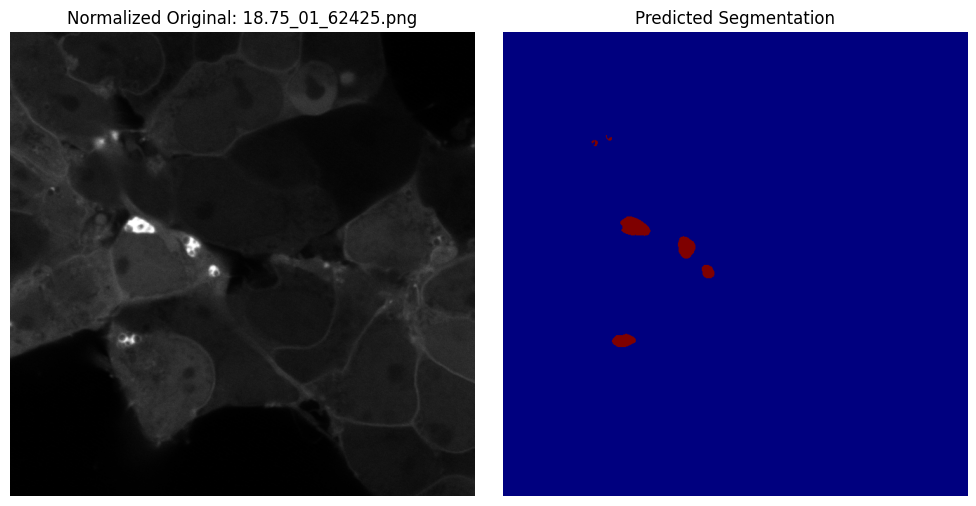

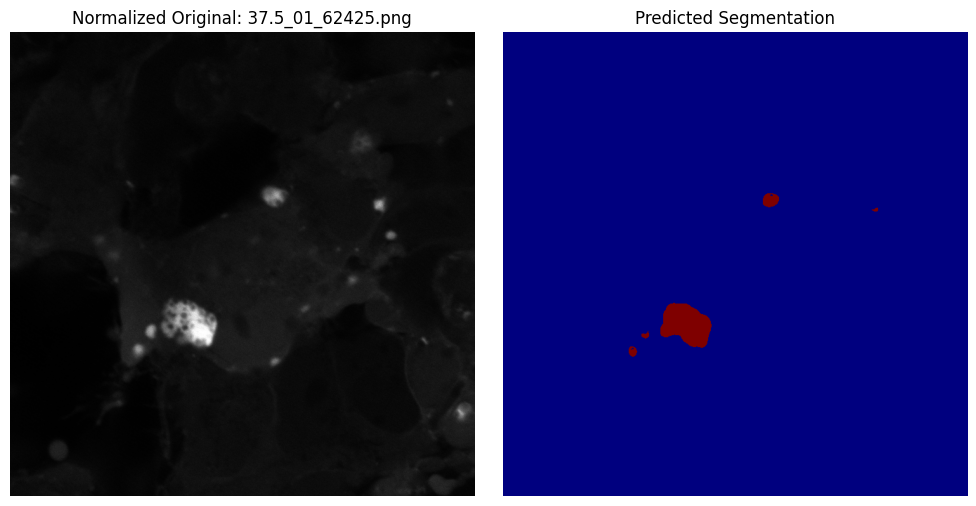

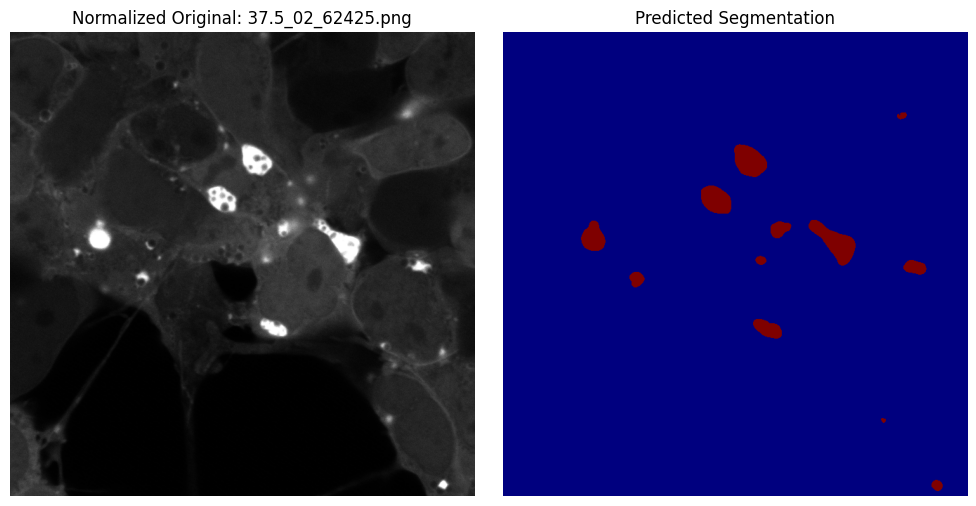

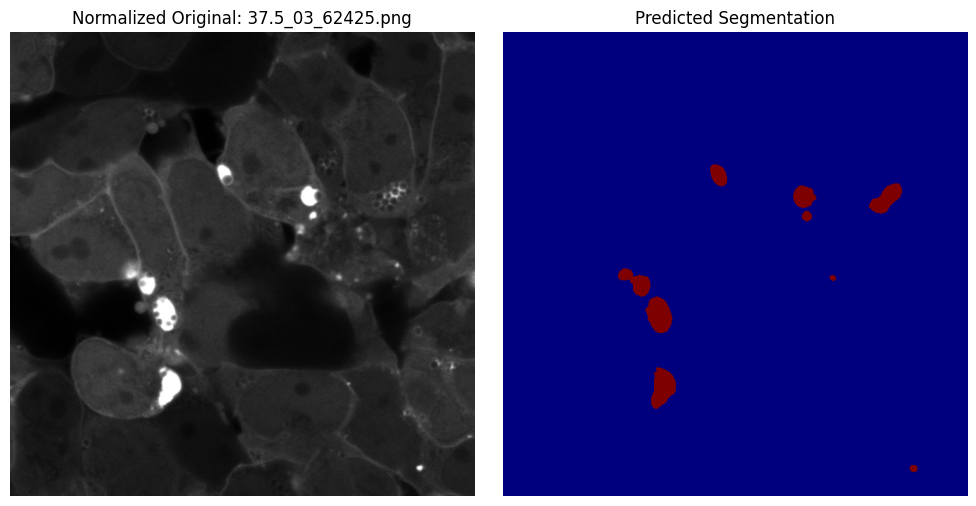

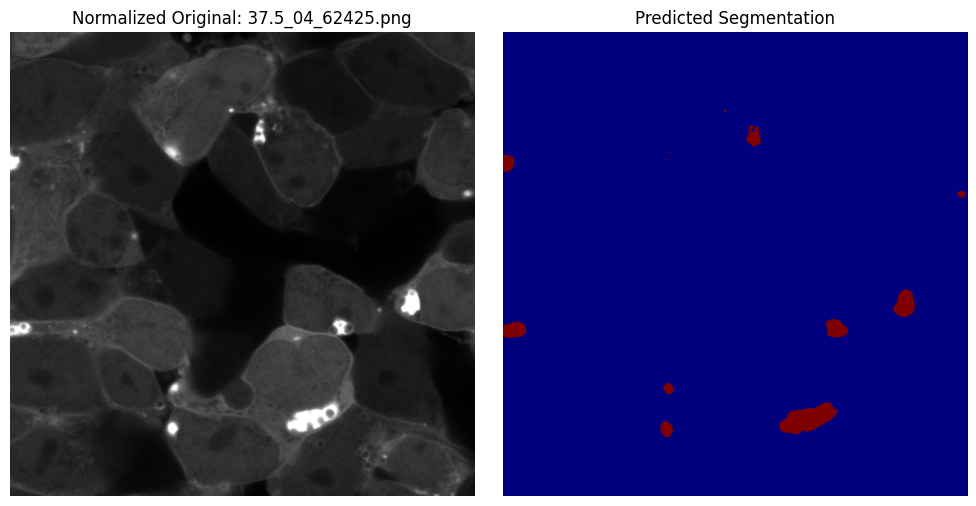

...

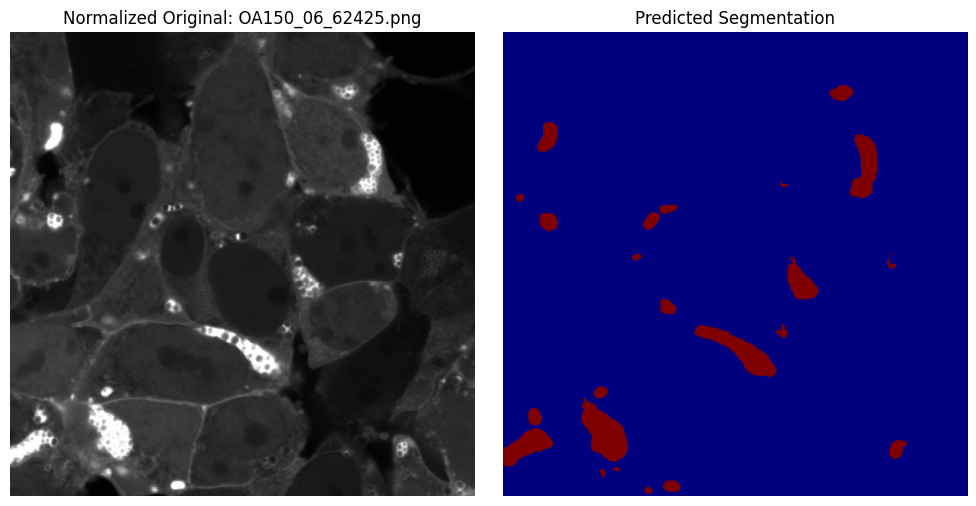

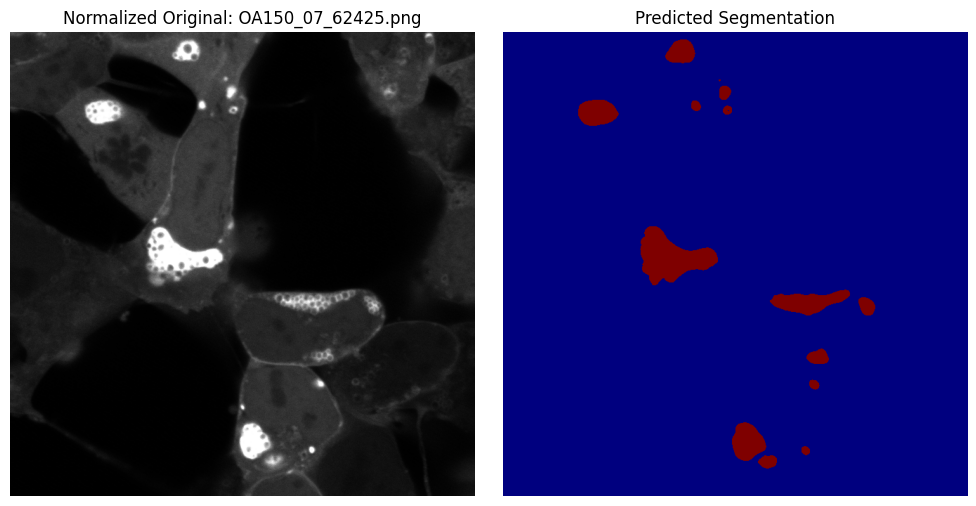

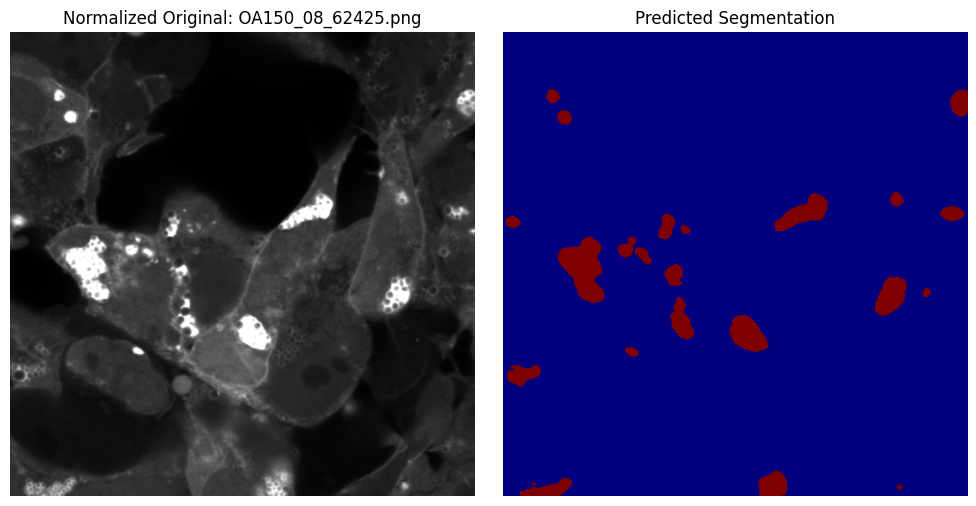

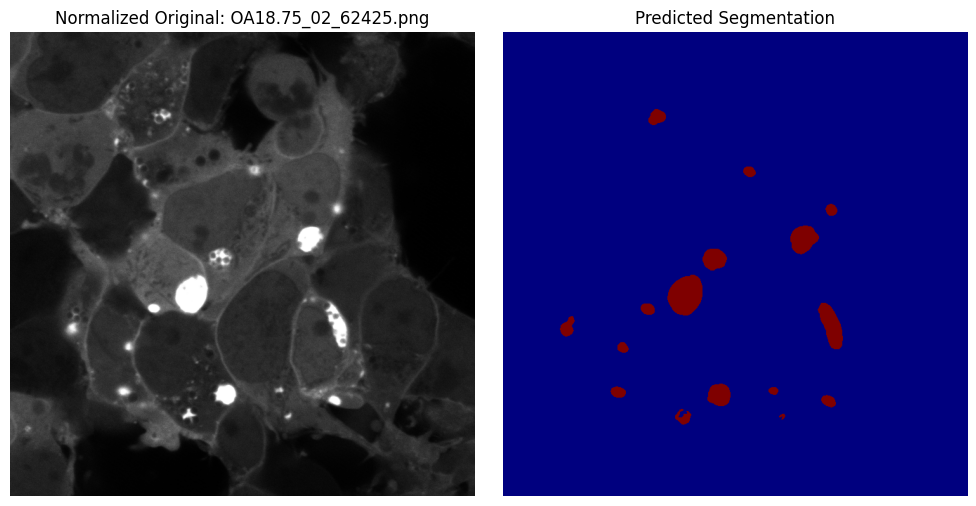

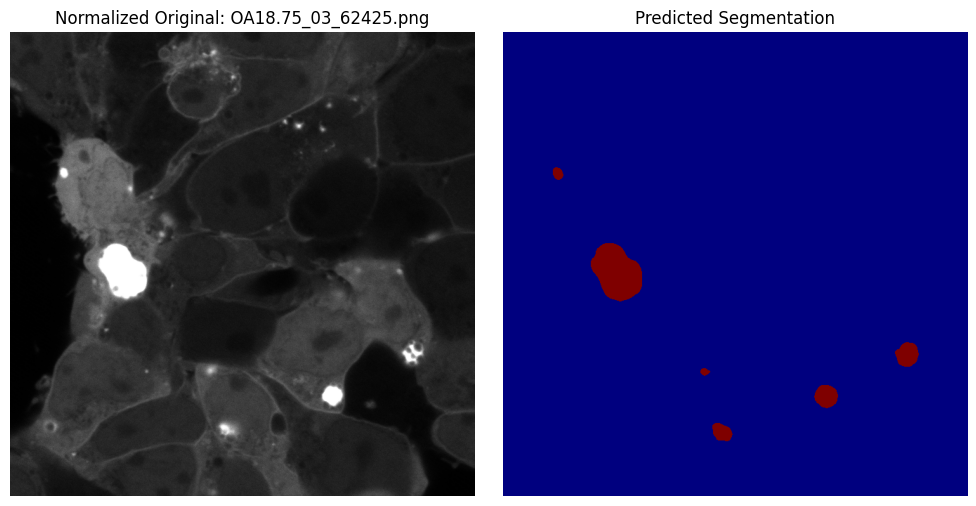

In [ ]:

predict_and_show_folder("/content/drive/MyDrive/test_set/images", model)